*.wav file can be found [here](https://labrosa.ee.columbia.edu/sounds/music/).

# Harmonic Analysis

Harmonic Analysis refers to identifying the chords in a particular song.

## Import Libraries

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt, matplotlib as mpl
import IPython.display as ipd
import scipy
import librosa, librosa.display
import pandas as pd
from itertools import permutations 
from pychord import note_to_chord, ChordProgression
plt.rcParams['figure.figsize'] = (20, 5)
mpl.style.use('fivethirtyeight')

## Load Audio

In [2]:
# x, sr = librosa.load('audio/dont_speak-no_doubt.wav', offset=2, duration=5)
x, sr = librosa.load('audio/dont_speak-no_doubt.wav')
x, ind = librosa.effects.trim(x)

### Harmonic Percussive Source Separation

Slice off beginning and ending silence?

#### Separate Audio

In [3]:
X = librosa.stft(x) # short term fourier transform
H, P = librosa.decompose.hpss(X)

"""
human perception of audio on log scale, 
so calculate for visualizations
"""
Xmag = librosa.amplitude_to_db(X)
Hmag = librosa.amplitude_to_db(H)
Pmag = librosa.amplitude_to_db(P)

/home/kat/anaconda3/lib/python3.7/site-packages/librosa/core/spectrum.py:1642: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  "amplitude_to_db was called on complex input so phase "


In [4]:
ipd.Audio(x, rate=sr)

In [5]:
h = librosa.istft(H) # inverse short time fourier transform
ipd.Audio(h, rate=sr)

In [6]:
p = librosa.istft(P)
ipd.Audio(p, rate=sr)

In [7]:
T = len(h)/float(sr)
tempo = librosa.beat.tempo(x, sr=sr)
secs_per_beat = 60.0/tempo[0]
beat_times = np.arange(0, T, secs_per_beat)

In [8]:
beat_times

array([  0.        ,   0.39473923,   0.78947846,   1.18421769,
         1.57895692,   1.97369615,   2.36843537,   2.7631746 ,
         3.15791383,   3.55265306,   3.94739229,   4.34213152,
         4.73687075,   5.13160998,   5.52634921,   5.92108844,
         6.31582766,   6.71056689,   7.10530612,   7.50004535,
         7.89478458,   8.28952381,   8.68426304,   9.07900227,
         9.4737415 ,   9.86848073,  10.26321995,  10.65795918,
        11.05269841,  11.44743764,  11.84217687,  12.2369161 ,
        12.63165533,  13.02639456,  13.42113379,  13.81587302,
        14.21061224,  14.60535147,  15.0000907 ,  15.39482993,
        15.78956916,  16.18430839,  16.57904762,  16.97378685,
        17.36852608,  17.76326531,  18.15800454,  18.55274376,
        18.94748299,  19.34222222,  19.73696145,  20.13170068,
        20.52643991,  20.92117914,  21.31591837,  21.7106576 ,
        22.10539683,  22.50013605,  22.89487528,  23.28961451,
        23.68435374,  24.07909297,  24.4738322 ,  24.86

#### Visualize  Spectograms

/home/kat/anaconda3/lib/python3.7/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/home/kat/anaconda3/lib/python3.7/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/home/kat/anaconda3/lib/python3.7/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


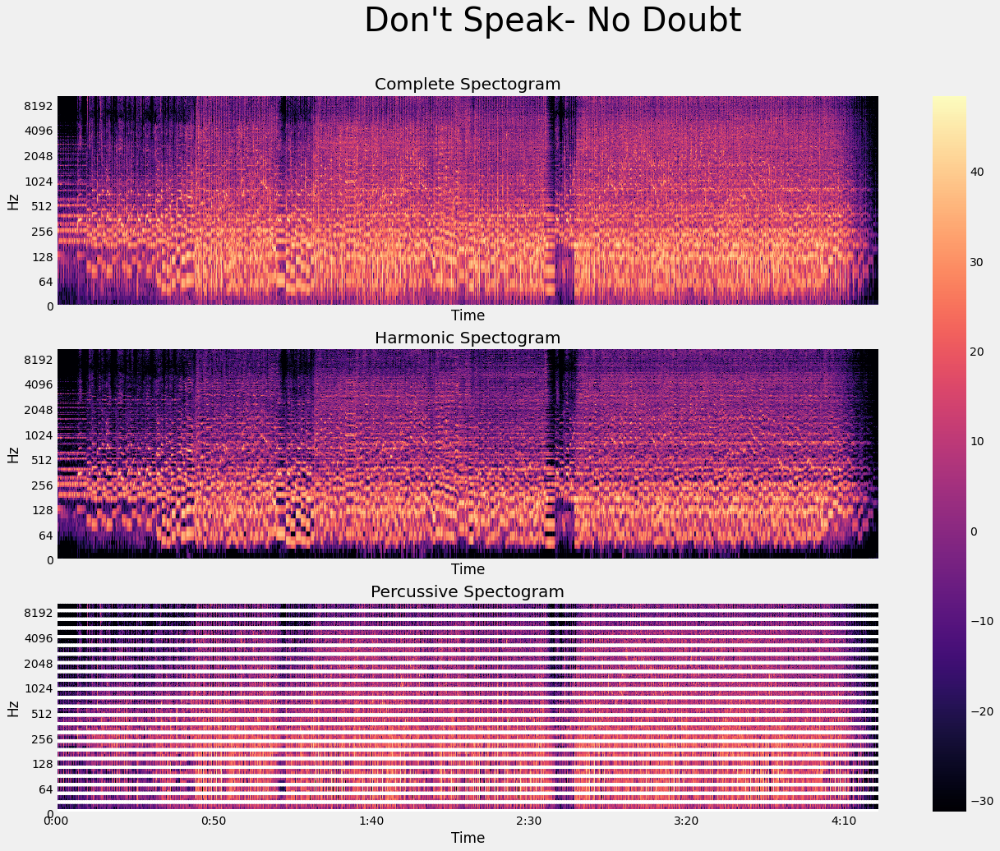

In [9]:
plt.rcParams['figure.figsize'] = (20, 15)
fig, ax = plt.subplots(nrows=3, ncols=1, sharex=True)
im = librosa.display.specshow(Xmag, sr=sr, x_axis='time', y_axis='log', cmap='magma', ax=ax[0])
ax[0].set(title='Complete Spectogram')
im = librosa.display.specshow(Hmag, sr=sr, x_axis='time', y_axis='log', cmap='magma', ax=ax[1])
ax[1].set(title='Harmonic Spectogram')
im = librosa.display.specshow(Pmag, sr=sr, x_axis='time', y_axis='log', cmap='magma', ax=ax[2])
ax[2].set(title='Percussive Spectogram')
fig.colorbar(im, ax=ax)
fig.suptitle('Don\'t Speak- No Doubt', fontsize=40)
ax[2].vlines(beat_times, 0, 12000, color='w', linestyles='dotted')

### Extract Features

We will extract chroma vectors, which describe the pitch class in a signal. Note that `librosa.feature.chroma_stft` returns normalized values.

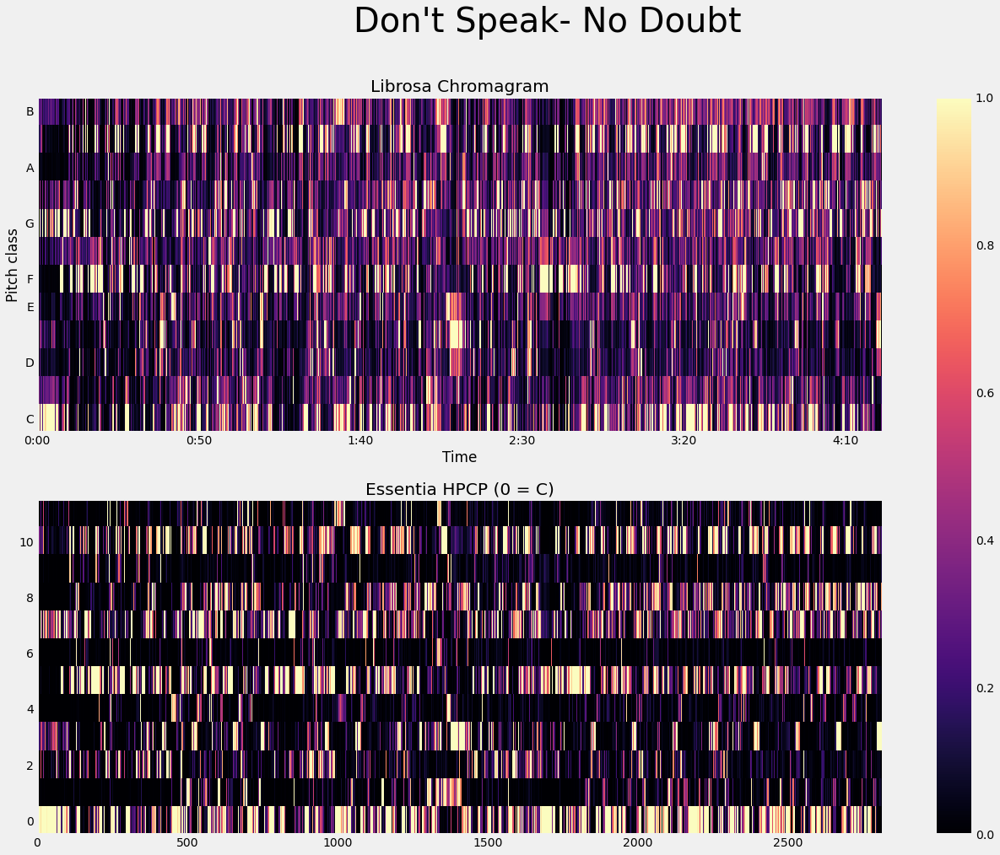

In [10]:
from essentia.pytools.spectral import hpcpgram

plt.rcParams["axes.grid"] = False
fig, ax = plt.subplots(nrows=2, ncols=1, sharex=False)
plt.rcParams['figure.figsize'] = (20, 15)
hop_length = 512

chromagram = librosa.feature.chroma_stft(h, sr=sr, hop_length=hop_length)
hpcp = hpcpgram(h, sampleRate=sr)

im = librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='magma', ax=ax[0])
ax[0].set(title='Librosa Chromagram')

# roll hpcp to align with chroma
im = plt.imshow(np.roll(hpcp, -3).T, aspect='auto', origin='lower', interpolation='none', cmap='magma')
ax[1].set(title='Essentia HPCP (0 = C)')

fig.suptitle('Don\'t Speak- No Doubt', fontsize=40)
fig.colorbar(im, ax=ax)

In [11]:
semitones = ['C','C#','D','D#','E','F','F#','G','G#','A','A#','B']
chroma_df = pd.DataFrame(chromagram.T, columns = semitones)
chroma_df.head()

,C,C#,D,D#,E,F,F#,G,G#,A,A#,B
0,0.437191,0.571273,0.738319,0.887735,0.977074,1.000000,0.936397,0.820125,0.669760,0.508602,0.371635,0.309761
1,0.663889,0.716831,0.825042,0.966095,1.000000,0.979007,0.911348,0.807053,0.728785,0.630444,0.559495,0.562934
2,0.741341,0.655909,0.775460,0.856026,0.930953,1.000000,0.944896,0.751362,0.687275,0.563807,0.486267,0.577283
3,1.000000,0.672824,0.634014,0.432052,0.556189,0.623110,0.590990,0.351413,0.293164,0.295245,0.351041,0.805830
4,1.000000,0.933504,0.838867,0.497804,0.626250,0.757064,0.689319,0.411516,0.267695,0.358273,0.368217,0.794718


In [12]:
hpcp_df = pd.DataFrame(hpcp, columns = np.roll(semitones, 3))
hpcp_df.head()

,A,A#,B,C,C#,D,D#,E,F,F#,G,G#
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.133175,0.658362,0.470334,1.000000,0.275842,0.370161,0.290470,0.386863,0.418241,0.338947,0.058452,0.334366
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,1.000000,0.125562,0.901960,0.162187,0.016567,0.152152,0.374922,0.940904,0.037757,0.157940,0.127848,0.161401


## Identify Chords

Extract triads by taking the three chroma with the highest amplitude per beat using `pychord`.  
We can use `pychord` to note the final harmonic progression.

In [13]:
def get_chord(beat):
    chord = []
    
    for i in range(3):
        maxInd = beat.idxmax(axis=1)
        note = maxInd.value_counts().index[0]
        chord.append(note)
        beat = beat.drop([note], axis=1)
    return chord

In [14]:
beat_frames = [int(i * sr / hop_length) for i in beat_times]
chroma_progression = []
hpcp_progression = []
for i in np.arange(0, len(beat_frames)-2, 2): # for every two beats
    beat = chroma_df[beat_frames[i]:beat_frames[i+2]]
    chroma_progression.append(get_chord(beat))

In [15]:
hpcp_beats = [int(i * len(hpcp) / T) for i in beat_times]
hpcp_beats
hpcp_progression = []
for i in np.arange(0, len(hpcp_beats)-2, 2): # for every two beats
    beat = hpcp_df[hpcp_beats[i]:hpcp_beats[i+2]]
    hpcp_progression.append(get_chord(beat))

In [16]:
chroma_progression

[['C', 'C#', 'B'],
 ['C', 'C#', 'B'],
 ['C', 'G', 'A#'],
 ['C', 'G', 'G#'],
 ['C', 'G', 'C#'],
 ['C', 'G', 'C#'],
 ['C', 'G', 'C#'],
 ['G', 'C', 'G#'],
 ['C', 'G', 'C#'],
 ['F', 'F#', 'E'],
 ['F', 'G', 'C'],
 ['G', 'C', 'G#'],
 ['C', 'G', 'C#'],
 ['F', 'F#', 'A#'],
 ['G', 'G#', 'F#'],
 ['G#', 'A', 'G'],
 ['F', 'G#', 'F#'],
 ['F', 'F#', 'E'],
 ['G', 'G#', 'F#'],
 ['A#', 'B', 'G'],
 ['G', 'F#', 'G#'],
 ['F', 'F#', 'E'],
 ['F', 'F#', 'E'],
 ['A#', 'F', 'B'],
 ['F', 'F#', 'E'],
 ['F', 'F#', 'E'],
 ['D#', 'D', 'E'],
 ['A#', 'D', 'B'],
 ['A#', 'B', 'C'],
 ['F', 'F#', 'G'],
 ['C', 'A#', 'F'],
 ['A#', 'B', 'C'],
 ['F', 'A#', 'F#'],
 ['F', 'F#', 'E'],
 ['A#', 'B', 'G'],
 ['C', 'C#', 'B'],
 ['G', 'G#', 'F#'],
 ['F', 'E', 'F#'],
 ['F', 'F#', 'E'],
 ['A#', 'B', 'F'],
 ['D#', 'A#', 'B'],
 ['F', 'D', 'F#'],
 ['G', 'C', 'D#'],
 ['G', 'A#', 'G#'],
 ['G', 'A#', 'G#'],
 ['G#', 'F', 'C'],
 ['F', 'D', 'A#'],
 ['A#', 'B', 'A'],
 ['A#', 'D#', 'E'],
 ['G', 'D#', 'E'],
 ['A#', 'B', 'G'],
 ['A#', 'B', 'A'],
 [

In [17]:
hpcp_progression

[['A', 'C', 'A#'],
 ['C', 'A#', 'D#'],
 ['C', 'G', 'A#'],
 ['C', 'G', 'D#'],
 ['C', 'G', 'D#'],
 ['C', 'G', 'D#'],
 ['C', 'D#', 'G'],
 ['C', 'G', 'D#'],
 ['C', 'G', 'D#'],
 ['F', 'C', 'G'],
 ['C', 'F', 'G'],
 ['C', 'G', 'D#'],
 ['C', 'G', 'D#'],
 ['F', 'A#', 'G'],
 ['A#', 'F', 'G'],
 ['C', 'G#', 'G'],
 ['C', 'F', 'G#'],
 ['F', 'A#', 'D'],
 ['F', 'A#', 'G'],
 ['G', 'A#', 'D'],
 ['F', 'G', 'C'],
 ['F', 'C', 'G#'],
 ['F', 'C', 'G'],
 ['F', 'A#', 'C'],
 ['C', 'F', 'D#'],
 ['F', 'C', 'G'],
 ['D#', 'F', 'C'],
 ['D', 'A#', 'A'],
 ['A#', 'G#', 'C'],
 ['C', 'F', 'G#'],
 ['C', 'F', 'G#'],
 ['A#', 'C', 'F'],
 ['F', 'D', 'A#'],
 ['F', 'G', 'A#'],
 ['A#', 'F', 'G'],
 ['C', 'G', 'B'],
 ['G', 'C', 'D'],
 ['F', 'G#', 'C'],
 ['F', 'C', 'G#'],
 ['F', 'D', 'A#'],
 ['D#', 'A#', 'C'],
 ['F', 'D', 'G'],
 ['C', 'G', 'D#'],
 ['G', 'D#', 'D'],
 ['G', 'A#', 'D'],
 ['G#', 'C', 'F'],
 ['F', 'C', 'G#'],
 ['F', 'A#', 'D'],
 ['A#', 'D', 'F'],
 ['D#', 'G', 'A#'],
 ['G', 'D#', 'E'],
 ['A#', 'D', 'F'],
 ['F', 'E', 'C']

In [18]:
def inversions_to_chord(voicing):
        inversions = list(permutations(voicing))
        for i in inversions:
            chord = note_to_chord(voicing)
            if chord:
                break
        return chord

In [19]:
chroma_results = []
hpcp_results = []

for i in range(len(chroma_progression)):
    chroma_results.append(inversions_to_chord(chroma_progression[i]))
for i in range(len(hpcp_progression)):
    hpcp_results.append(inversions_to_chord(hpcp_progression[i]))

## Evaluate

My own transcription of chord structure compared to the findings:  
*Cm*

In [20]:
chroma_results = list(filter(None, chroma_results))
chroma_results

[[<Chord: Fsus2>, <Chord: Csus4/F>],
 [<Chord: Cm/G>],
 [<Chord: G#/D#>],
 [<Chord: Fm/G#>],
 [<Chord: Csus4>, <Chord: Fsus2/C>],
 [<Chord: Cm/G>],
 [<Chord: Gsus4>, <Chord: Csus2/G>],
 [<Chord: Gsus4>, <Chord: Csus2/G>]]

In [21]:
hpcp_results = list(filter(None, hpcp_results))
hpcp_results

[[<Chord: Cm>],
 [<Chord: Csus4>, <Chord: Fsus2/C>],
 [<Chord: Fm/C>],
 [<Chord: A#/F>],
 [<Chord: Gm>],
 [<Chord: Fsus2>, <Chord: Csus4/F>],
 [<Chord: Fsus4>, <Chord: A#sus2/F>],
 [<Chord: Fm/C>],
 [<Chord: Fm/C>],
 [<Chord: A#sus2>, <Chord: Fsus4/A#>],
 [<Chord: Gsus4>, <Chord: Csus2/G>],
 [<Chord: Fm>],
 [<Chord: Gm>],
 [<Chord: Fm/G#>],
 [<Chord: A#/F>],
 [<Chord: A#>],
 [<Chord: D#>],
 [<Chord: A#>],
 [<Chord: C>],
 [<Chord: C>],
 [<Chord: Fm>],
 [<Chord: A#m/C#>],
 [<Chord: D#>],
 [<Chord: C/G>],
 [<Chord: Gdim>],
 [<Chord: Fm/C>],
 [<Chord: Fm/G#>],
 [<Chord: Fsus4>, <Chord: A#sus2/F>],
 [<Chord: Fm>],
 [<Chord: D#>],
 [<Chord: D#/A#>],
 [<Chord: Fm/G#>],
 [<Chord: D#>],
 [<Chord: A#/F>],
 [<Chord: Gm>],
 [<Chord: Csus2>, <Chord: Gsus4/C>],
 [<Chord: A#/F>],
 [<Chord: Fm/C>],
 [<Chord: Fm/C>],
 [<Chord: D#/A#>],
 [<Chord: C/G>],
 [<Chord: C/G>],
 [<Chord: Fsus2>, <Chord: Csus4/F>],
 [<Chord: Fm/C>],
 [<Chord: A#>],
 [<Chord: Fsus4/C>, <Chord: A#sus2/C>],
 [<Chord: Bsus2>, <Chord